# The ultimatum game

In this notebook several simulations of the ultimatum game are run using the player_1, player_2 and ultimatum classes defined in the other modules of this repository.

In [1]:
from player import player_1, player_2
from ultimatum import ultimatum
import plotly.express as px
import plotly.figure_factory as ff
import numpy as np
from matplotlib import pyplot as plt
import pandas as pd
from plotly.subplots import make_subplots

## One shot repeated game

First, one simulation is runned to understand how each works.

In [1]:
#The parameters for the agents and the game are set.
endowment = 100
epsilon = 0.1
alpha = 0.2
policy = 0.2

In [3]:
#The agents are created as an instance of the players class defined. The game is an instance of the ultimatum class created.
agent_a = player_1(epsilon = epsilon, alpha_learn_rate = alpha,actions = endowment)

agent_b = player_2(epsilon = epsilon,alpha_learn_rate = alpha,states = endowment)

game = ultimatum(episodes = 10000, player_1 = agent_a, player_2 = agent_b, endowment = endowment, policy = policy)

In [4]:
#With the instance created, the method play runs the number of episodes set and saves the results to a dataframe.
game.play()
game.results["B's action"] = game.results["B's action"].astype(str)

Partial results of the 10.000 episodes played are shown:
- It can be observed that the agent A initializes the offer in 0 as it has the maximum q-value, however after the exploration of actions during the game, the offers shift.
- The average action for agent B growths with time, showing the learning to accept all offers made by agent A as they maximize utility in every episode. 

In [5]:
game.results.iloc[np.r_[0:3,1000:1003, -3:0]]

,A's offer,B's action,B's average actions,A's reward,B's reward,A's payoffs,B's payoffs
0,0,0,0.000000,0,0,0,0
1,0,0,0.000000,0,0,0,0
2,0,0,0.000000,0,0,0,0
1000,34,1,0.838162,66,34,55283,28617
1001,34,1,0.838323,66,34,55349,28651
1002,34,1,0.838485,66,34,55415,28685
9997,4,1,0.876075,96,4,736269,139631
9998,4,1,0.876088,96,4,736365,139635
9999,4,1,0.876100,96,4,736461,139639


#### Results for agent A.

In the plot we can see the the offers made by agent A in each episode of the simulation, every dot is an offer, the lines are made of consequent offers of the same level. The colors represent the action by agent B in each episode. 
It can be seen the process of learnig by the agent A, exploring the options and realizing that decresing the offer makes for higher rewards.

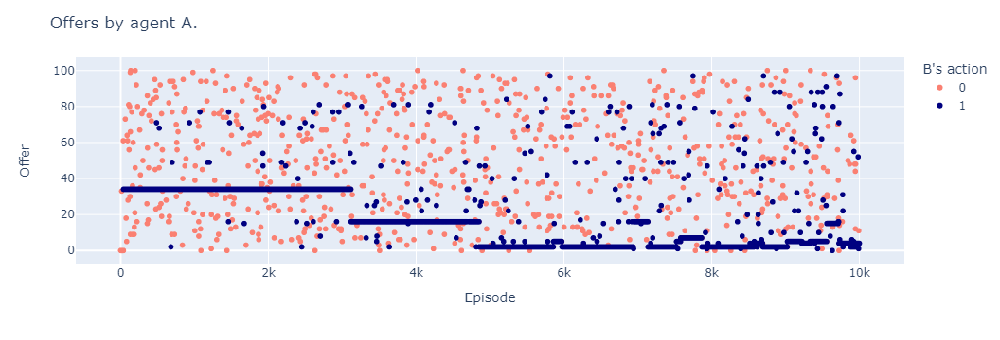

In [6]:
fig = px.scatter(game.results, y="A's offer", color = "B's action",color_discrete_sequence = ["salmon","navy"])
fig.update_layout(title = "Offers by agent A.",xaxis_title="Episode",yaxis_title = "Offer")
fig.show()

In the distribution made out of the agent A's actions it can be seen how the majority are made towards the lower bound of the endowment. 

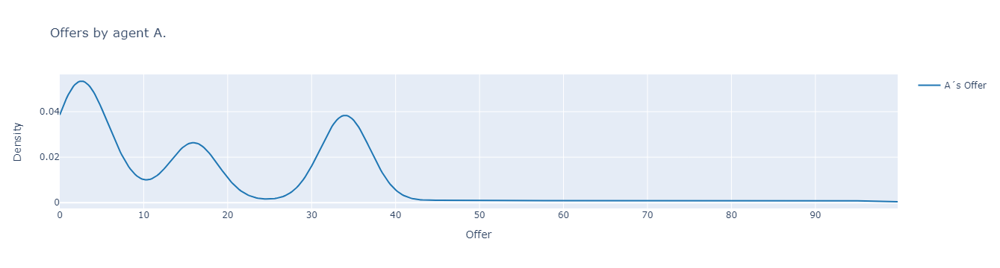

In [7]:
fig = ff.create_distplot([game.results["A's offer"]],group_labels = ["A´s Offer"],bin_size=10,show_hist = False, show_rug=False)
fig.update_layout(title = "Offers by agent A.",xaxis_title="Offer",yaxis_title = "Density")
fig.show()

The rewards plot for agent A show the growth caused by the learning process.

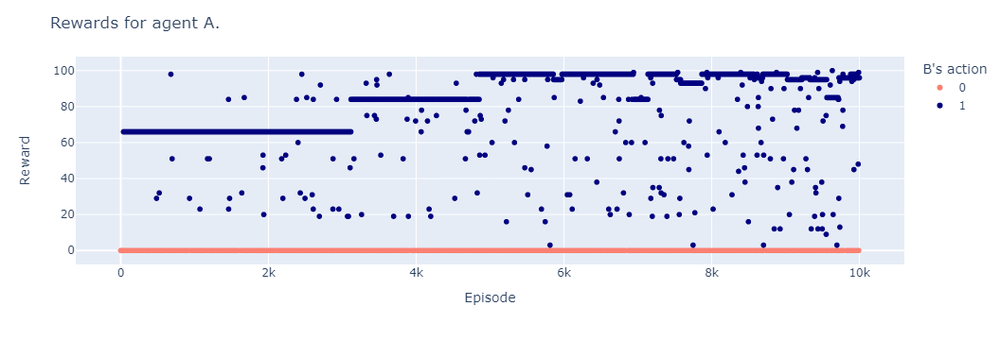

In [8]:
fig = px.scatter(game.results, y="A's reward", color = "B's action",color_discrete_sequence = ["salmon","navy"])
fig.update_layout(title = "Rewards for agent A.",xaxis_title="Episode",yaxis_title = "Reward")
fig.show()

#### Results for agent B.

In the plot we can see the the average of all actions taken by agent B for each episode. It can be observed how the agent learns fast that accepting every offer makes for a higher reward than rejecting, for that the action thends to be "accept" the offer, that is action 1. 

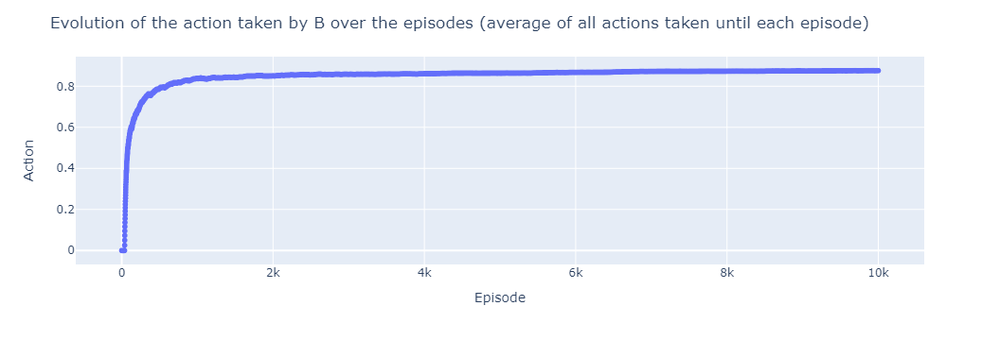

In [12]:
fig = px.scatter(game.results, y="B's average actions")
fig.update_layout(title = "Evolution of the action taken by B over the episodes (average of all actions taken until each episode)",xaxis_title="Episode",yaxis_title = "Action")
fig.show()

The next histogram shows that most of the actions by agent B in the simulation are of value 1.

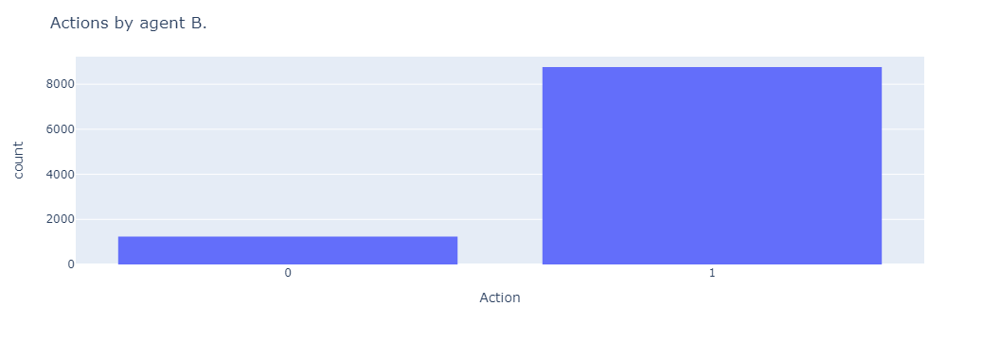

In [11]:
fig = px.histogram(game.results, x = "B's action")
fig.update_layout(title = "Actions by agent B.",xaxis_title="Action")
fig.show()

However, because of the learning process for agent B, the rewards decrease over time, since agent A learns that agent B will accept evey offer.

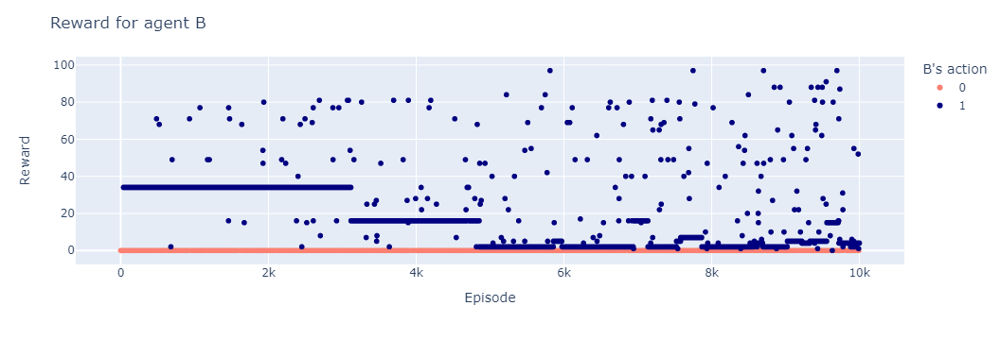

In [10]:
fig = px.scatter(game.results, y="B's reward", color = "B's action", color_discrete_sequence = ["salmon","navy"])
fig.update_layout(title = "Reward for agent B",xaxis_title="Episode",yaxis_title = "Reward")
fig.show()

### Exploring parameters for the agents

In this part of the notebook, several simulations are run with different values of epsilon and alpha to identify the optimal value for each agent. 

#### epsilon

Epsilon will take the representative values: 0.01, 0.1, 0.5 and 1 for each player, the average across simulatons for each episode is studied.

In [2]:
endowment = 100
alpha = 0.2
n_simulations = 50
policy = 0.2

In [3]:
average_a_actions_dynamic = []
average_b_actions_dynamic = []
average_a_rewards_dynamic = []
average_b_rewards_dynamic = []

names = []

for epsilon in list([0.01,0.1,0.5,1]):
    
    agent_a_actions = []
    agent_b_actions = []
    agent_a_rewards = []
    agent_b_rewards = []

    for i in range(n_simulations):
        agent_a = player_1(epsilon = epsilon, alpha_learn_rate=alpha,actions = endowment)
        agent_b = player_2(epsilon = epsilon,alpha_learn_rate=alpha,states = endowment)
        game = ultimatum(episodes = 10000, player_1 = agent_a, player_2 = agent_b, endowment = endowment, policy = policy)
        game.play()
        agent_a_actions.append(game.player_1_actions)
        agent_b_actions.append(game.player_2_actions)
        agent_a_rewards.append(game.player_1_rewards)
        agent_b_rewards.append(game.player_2_rewards)
    
    average_a_actions = np.mean(agent_a_actions, axis=0)
    average_a_actions_dynamic.append(average_a_actions)
    
    average_b_actions = np.mean(agent_b_actions, axis = 0)
    average_b_actions_dynamic.append(average_b_actions)
    
    average_a_rewards = np.mean(agent_a_rewards, axis = 0)
    average_a_rewards_dynamic.append(average_a_rewards)
    
    average_b_rewards = np.mean(agent_b_rewards, axis = 0)
    average_b_rewards_dynamic.append(average_b_rewards)
    
    names.append(f"epsilon = {epsilon}")

In [4]:
df_average_actions_a = pd.DataFrame(data = average_a_actions_dynamic).transpose()
df_average_actions_a.columns = names
df_average_actions_b = pd.DataFrame(data = average_b_actions_dynamic).transpose()
df_average_actions_b.columns = names
df_average_rewards_a = pd.DataFrame(data = average_a_rewards_dynamic).transpose()
df_average_rewards_a.columns = names
df_average_rewards_b = pd.DataFrame(data = average_b_rewards_dynamic).transpose()
df_average_rewards_b.columns = names

##### Results for agent A

The partial results of the average action for each episode for each value of alpha is shown in the table. 

In [5]:
df_average_actions_a.iloc[np.r_[0:3,1000:1003, -3:0]]

,epsilon = 0.01,epsilon = 0.1,epsilon = 0.5,epsilon = 1
0,0.46,1.66,26.32,52.80
1,0.00,5.40,24.72,50.24
2,0.00,5.72,23.76,64.26
1000,0.60,40.56,26.08,50.76
1001,1.68,42.18,35.36,54.82
1002,0.60,38.58,29.92,50.78
9997,24.20,10.58,30.58,54.42
9998,24.28,14.04,32.70,54.72
9999,23.84,13.44,30.46,55.04


In the plot it is clear that with an epsilon too high or too low the agent does not learn fast how to minimize the offers to maximize the rewards. The fastest and most consistent learning pattern is found when epsilon takes the value of 0.1.

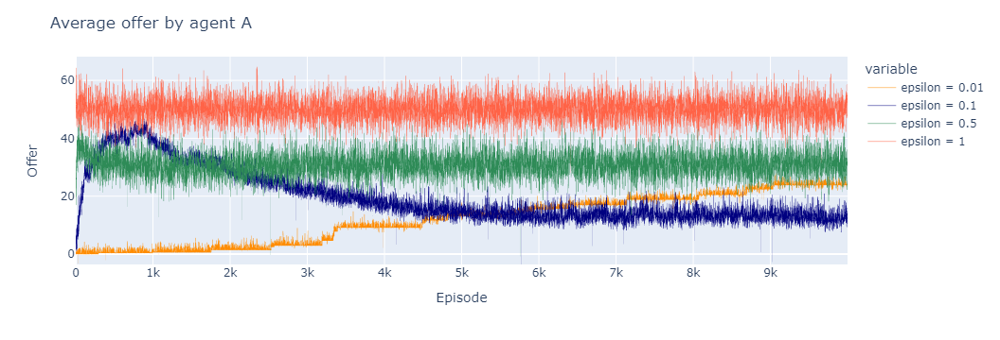

In [6]:
fig = px.line(df_average_actions_a,y=["epsilon = 0.01","epsilon = 0.1","epsilon = 0.5","epsilon = 1"], color_discrete_sequence = ["darkorange","navy","seagreen","tomato"])
fig.update_traces(line=dict(width=0.5))
fig.update_layout(title = "Average offer by agent A",xaxis_title="Episode",yaxis_title = "Offer")
fig.show()

The partial results of the average reward for each episode for each value of alpha is shown in the table. 

In [7]:
df_average_rewards_a.iloc[np.r_[0:3,1000:1003, -3:0]]

,epsilon = 0.01,epsilon = 0.1,epsilon = 0.5,epsilon = 1
0,0.00,6.00,18.18,25.28
1,0.00,6.00,17.52,26.10
2,0.00,0.00,22.94,15.80
1000,1.64,53.72,53.50,20.80
1001,5.40,48.96,47.24,30.74
1002,5.40,58.00,38.98,27.64
9997,19.56,83.22,55.60,21.22
9998,20.16,78.02,58.74,23.26
9999,20.16,77.94,40.10,23.06


Given the faster learning process when epsilon is set to 0.1, the rewards are also maximized in this case. 

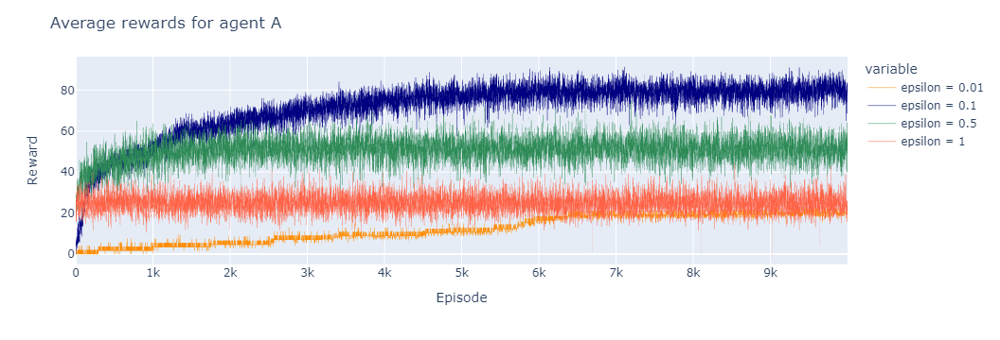

In [8]:
fig = px.line(df_average_rewards_a,y=["epsilon = 0.01","epsilon = 0.1","epsilon = 0.5","epsilon = 1"],color_discrete_sequence = ["darkorange","navy","seagreen","tomato"])
fig.update_traces(line=dict(width=0.5))
fig.update_layout(title = "Average rewards for agent A",xaxis_title="Episode",yaxis_title = "Reward")
fig.show()

The average total payoff for different values of epsilon confirm that for agent A the optimal value of epsilon is 0.1.

In [9]:
list_epsilon = ["epsilon = 0.01","epsilon = 0.1","epsilon = 0.5", "epsilon = 1"]
for i in list_epsilon:
    print(f"Total of average rewards for {i}: {sum(df_average_rewards_a[i])}")

Total of average rewards for epsilon = 0.01: 120184.9799999953
Total of average rewards for epsilon = 0.1: 710322.8599999996
Total of average rewards for epsilon = 0.5: 506083.6600000003
Total of average rewards for epsilon = 1: 249521.6400000006


##### Results for agent B.
In the table, the average action taken by agent B is shown for different episodes. 

In [10]:
df_average_actions_b.iloc[np.r_[0:3,1000:1003, -3:0]]

,epsilon = 0.01,epsilon = 0.1,epsilon = 0.5,epsilon = 1
0,0.00,0.06,0.24,0.54
1,0.00,0.06,0.24,0.50
2,0.00,0.00,0.30,0.44
1000,0.02,0.90,0.70,0.36
1001,0.06,0.84,0.70,0.62
1002,0.06,0.96,0.50,0.60
9997,0.42,0.92,0.76,0.44
9998,0.44,0.86,0.86,0.52
9999,0.44,0.88,0.60,0.54


In the Plot it can be observed that with an epsilon of value 0.1 the agent learns faster to accept every offer made by agent A. 

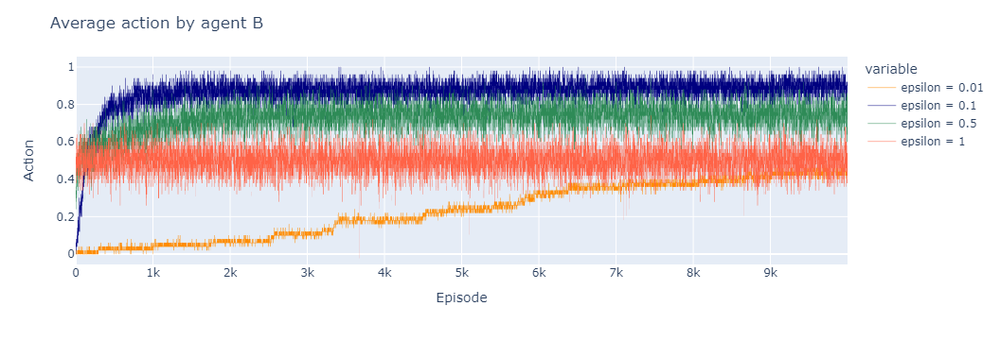

In [11]:
fig = px.line(df_average_actions_b,y=["epsilon = 0.01","epsilon = 0.1","epsilon = 0.5","epsilon = 1"],color_discrete_sequence = ["darkorange","navy","seagreen","tomato"])
fig.update_traces(line=dict(width=0.5))
fig.update_layout(title = "Average action by agent B",xaxis_title="Episode",yaxis_title = "Action")
fig.show()

The table shows the average reward for some episodes according to different values of epsilon. It can be seen how the rewards increase with epsilon. 

In [12]:
df_average_rewards_b.iloc[np.r_[0:3,1000:1003, -3:0]]

,epsilon = 0.01,epsilon = 0.1,epsilon = 0.5,epsilon = 1
0,0.00,0.00,5.82,28.72
1,0.00,0.00,6.48,23.90
2,0.00,0.00,7.06,28.20
1000,0.36,36.28,16.50,15.20
1001,0.60,35.04,22.76,31.26
1002,0.60,38.00,11.02,32.36
9997,22.44,8.78,20.40,22.78
9998,23.84,7.98,27.26,28.74
9999,23.84,10.06,19.90,30.94


In the plot it is clearer how the rewards for agent B fastly decrease when the epsilon parameter allows it to learn faster to accept all offers. Indeed, with this behavior, the agent A learns faster to minimize the offers, for that, rewards are minimized for agent B. 

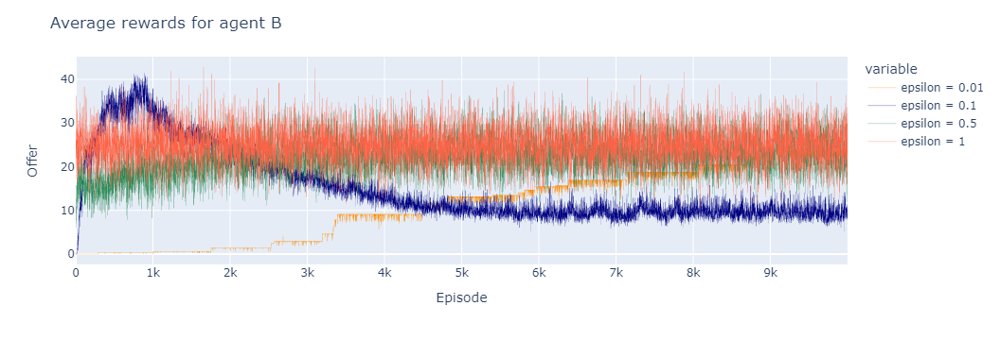

In [13]:
fig = px.line(df_average_rewards_b,y=["epsilon = 0.01","epsilon = 0.1","epsilon = 0.5", "epsilon = 1"], color_discrete_sequence = ["darkorange","navy","seagreen","tomato"])
fig.update_traces(line=dict(width=0.3))
fig.update_layout(title = "Average rewards for agent B",xaxis_title="Episode",yaxis_title = "Offer")
fig.show()

The average total payoff for every value of epsilon confirms that for agent B the optimal value of epsilon is 1. Like this, the agent randomly choses an action in every episode, making it difficult for agent A to learn to minimize the offers and therefore maximizing the rewards. 

In [43]:
list_epsilon = ["epsilon = 0.01","epsilon = 0.1","epsilon = 0.5", "epsilon = 1"]
for i in list_epsilon:
    print(f"Total of average rewards for {i}: {sum(df_average_rewards_b[i])}")

Total of average rewards for epsilon = 0.01: 131312.6400000053
Total of average rewards for epsilon = 0.1: 139098.92000000025
Total of average rewards for epsilon = 0.5: 219584.75999999986
Total of average rewards for epsilon = 1: 249640.30000000037


#### alpha

Alpha will take the representative values: 0.01, 0.1, 0.5 and 1 for each player, the average across simulatons for each episode is studied.

In [2]:
endowment = 100
epsilon = 0.1
n_simulations = 50
policy = 0.2

In [3]:
average_a_actions_dynamic = []
average_b_actions_dynamic = []
average_a_rewards_dynamic = []
average_b_rewards_dynamic = []

names = []

for alpha in list([0.01,0.1,0.5,1]):
    
    agent_a_actions = []
    agent_b_actions = []
    agent_a_rewards = []
    agent_b_rewards = []

    for i in range(n_simulations):
        agent_a = player_1(epsilon = epsilon, alpha_learn_rate=alpha,actions = endowment)
        agent_b = player_2(epsilon = epsilon,alpha_learn_rate=alpha,states = endowment)
        game = ultimatum(episodes = 10000, player_1 = agent_a, player_2 = agent_b, endowment = endowment, policy = policy)
        game.play()
        agent_a_actions.append(game.player_1_actions)
        agent_b_actions.append(game.player_2_actions)
        agent_a_rewards.append(game.player_1_rewards)
        agent_b_rewards.append(game.player_2_rewards)
    
    average_a_actions = np.mean(agent_a_actions, axis=0)
    average_a_actions_dynamic.append(average_a_actions)
    
    average_b_actions = np.mean(agent_b_actions, axis = 0)
    average_b_actions_dynamic.append(average_b_actions)
    
    average_a_rewards = np.mean(agent_a_rewards, axis = 0)
    average_a_rewards_dynamic.append(average_a_rewards)
    
    average_b_rewards = np.mean(agent_b_rewards, axis = 0)
    average_b_rewards_dynamic.append(average_b_rewards)
    
    names.append(f"alpha = {alpha}")

In [4]:
df_average_actions_a = pd.DataFrame(data = average_a_actions_dynamic).transpose()
df_average_actions_a.columns = names
df_average_actions_b = pd.DataFrame(data = average_b_actions_dynamic).transpose()
df_average_actions_b.columns = names
df_average_rewards_a = pd.DataFrame(data = average_a_rewards_dynamic).transpose()
df_average_rewards_a.columns = names
df_average_rewards_b = pd.DataFrame(data = average_b_rewards_dynamic).transpose()
df_average_rewards_b.columns = names

##### Results for agent A

The partial results of the average action for each episode for each value of alpha is shown in the table. 

In [5]:
df_average_actions_a.iloc[np.r_[0:3,1000:1003, -3:0]]

,alpha = 0.01,alpha = 0.1,alpha = 0.5,alpha = 1
0,7.88,8.46,4.06,5.44
1,4.88,3.36,8.30,5.48
2,6.18,7.44,3.10,4.72
1000,10.02,40.94,22.82,14.10
1001,14.54,41.18,22.38,13.80
1002,10.50,40.32,22.44,9.62
9997,20.60,14.48,20.20,35.76
9998,17.46,16.62,19.94,38.92
9999,18.96,17.72,16.22,34.46


The plot below shoes the path of offers for different alpha values. It can be seen that in average the offers grow fast in the first thousand of episodes for later slowly decrease, towards the theoretic solution of the game, when the alpha is 0.1 or 0.5. On the other hand, when alpha is either too small (0.01) or too large (1), the offers grow during the first thousands of episodes and then stay rather constant. 

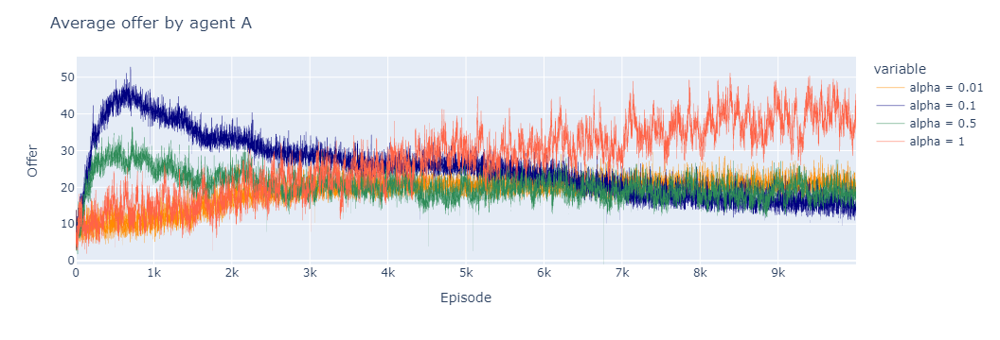

In [6]:
fig = px.line(df_average_actions_a,y=["alpha = 0.01","alpha = 0.1","alpha = 0.5","alpha = 1"], color_discrete_sequence = ["darkorange","navy","seagreen","tomato"])
fig.update_traces(line=dict(width=0.5))
fig.update_layout(title = "Average offer by agent A",xaxis_title="Episode",yaxis_title = "Offer")
fig.show()

As for the rewards for agent A, they seem to grow with time when the alpha value is set to be 0.1 or 0.5 and stay high for the rest of the simulation. At the same time, when the alpha value is too low the rewards grow very slowly during the timelapse of the simulation. 

In [7]:
df_average_rewards_a.iloc[np.r_[0:3,1000:1003, -3:0]]

,alpha = 0.01,alpha = 0.1,alpha = 0.5,alpha = 1
0,0.04,2.00,6.00,6.00
1,6.00,2.00,7.30,10.00
2,6.04,0.00,3.26,2.00
1000,19.14,54.48,74.12,15.92
1001,19.84,55.92,73.58,19.92
1002,15.66,53.96,77.30,20.54
9997,71.60,76.14,73.08,52.52
9998,78.92,74.12,68.82,45.52
9999,76.28,76.08,82.76,50.88


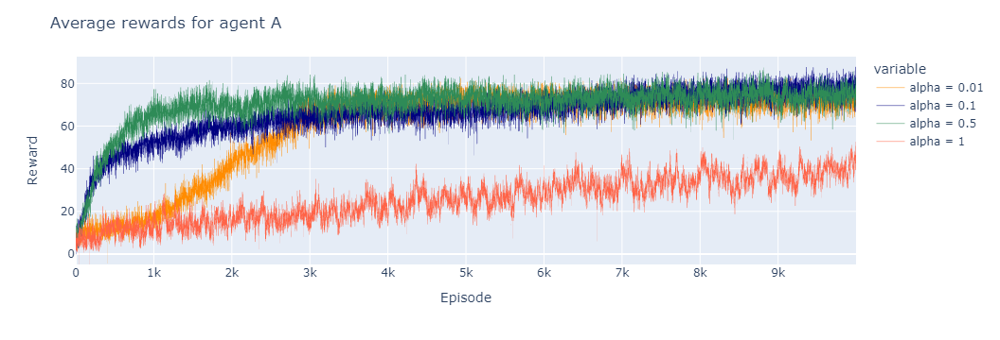

In [8]:
fig = px.line(df_average_rewards_a,y=["alpha = 0.01","alpha = 0.1","alpha = 0.5","alpha = 1"],color_discrete_sequence = ["darkorange","navy","seagreen","tomato"])
fig.update_traces(line=dict(width=0.5))
fig.update_layout(title = "Average rewards for agent A",xaxis_title="Episode",yaxis_title = "Reward")
fig.show()

The average of total payoff across simulations show that the value of 0.5 is the optimal for agent A. 

In [9]:
list_epsilon = ["alpha = 0.01","alpha = 0.1","alpha = 0.5","alpha = 1"]
for i in list_epsilon:
    print(f"Total of average rewards for {i}: {sum(df_average_rewards_a[i])}")

Total of average rewards for alpha = 0.01: 594630.2200000006
Total of average rewards for alpha = 0.1: 658494.439999999
Total of average rewards for alpha = 0.5: 700557.5600000008
Total of average rewards for alpha = 1: 253727.69999999893


##### Results for agent B.
In the table, the average action taken by agent B is shown for different episodes. 

In [10]:
df_average_actions_b.iloc[np.r_[0:3,1000:1003, -3:0]]

,alpha = 0.01,alpha = 0.1,alpha = 0.5,alpha = 1
0,0.02,0.02,0.06,0.06
1,0.06,0.02,0.08,0.10
2,0.08,0.00,0.04,0.02
1000,0.24,0.90,0.94,0.26
1001,0.28,0.94,0.94,0.30
1002,0.22,0.92,0.98,0.30
9997,0.88,0.86,0.88,0.88
9998,0.96,0.86,0.84,0.78
9999,0.92,0.88,0.98,0.82


The plot shows the evolution in each episode across simulations for the action taken by agent B. 
It is seen that the path for actions grows faster when the value of alpha is . 

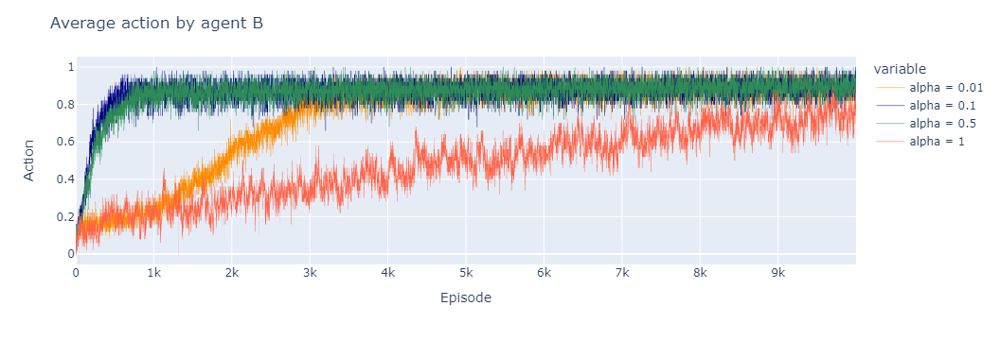

In [11]:
fig = px.line(df_average_actions_b,y=["alpha = 0.01","alpha = 0.1","alpha = 0.5","alpha = 1"],color_discrete_sequence = ["darkorange","navy","seagreen","tomato"])
fig.update_traces(line=dict(width=0.5))
fig.update_layout(title = "Average action by agent B",xaxis_title="Episode",yaxis_title = "Action")
fig.show()

The rewards increase sharply and then decrease during the simulations when the alpha value is 0.1 or 0.5, while they grow slowly when alpha is either too small (0.01) or too large (1). 

In [12]:
df_average_rewards_b.iloc[np.r_[0:3,1000:1003, -3:0]]

,alpha = 0.01,alpha = 0.1,alpha = 0.5,alpha = 1
0,1.96,0.00,0.00,0.00
1,0.00,0.00,0.70,0.00
2,1.96,0.00,0.74,0.00
1000,4.86,35.52,19.88,10.08
1001,8.16,38.08,20.42,10.08
1002,6.34,38.04,20.70,9.46
9997,16.40,9.86,14.92,35.48
9998,17.08,11.88,15.18,32.48
9999,15.72,11.92,15.24,31.12


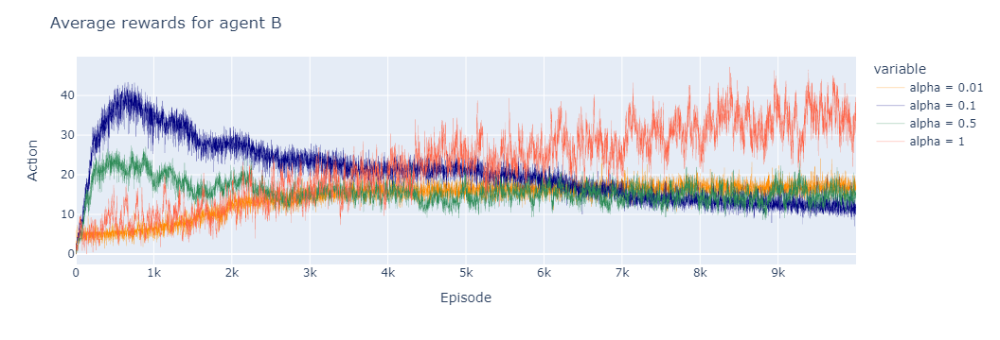

In [13]:
fig = px.line(df_average_rewards_b,y=["alpha = 0.01","alpha = 0.1","alpha = 0.5","alpha = 1"], color_discrete_sequence = ["darkorange","navy","seagreen","tomato"])
fig.update_traces(line=dict(width=0.3))
fig.update_layout(title = "Average rewards for agent B",xaxis_title="Episode",yaxis_title = "Action")
fig.show()

From the average of total payoffs for each value of alpha it can be concluded that the best value of alpha for agent B is 1.

In [14]:
list_epsilon = ["alpha = 0.01","alpha = 0.1","alpha = 0.5","alpha = 1"]
for i in list_epsilon:
    print(f"Total of average rewards for {i}: {sum(df_average_rewards_b[i])}")

Total of average rewards for alpha = 0.01: 142149.77999999997
Total of average rewards for alpha = 0.1: 205219.55999999936
Total of average rewards for alpha = 0.5: 157274.44000000047
Total of average rewards for alpha = 1: 225412.3000000009


### New game with best parameters for each player

For this new set of simulations the set of parameters will be different for each agent, using the optimal values for each parameter. A total of 50 simulations will be run to analyse the results. It is necessary to keep in mind that the value of alpha for player B ends up being non important, because if epsilon is equal to 1, all actions are randomized and not depending on the values of the q table for agent B. 

In [3]:
endowment = 100
epsilon_a = 0.1
epsilon_b = 1
alpha_a = 0.5
alpha_b = 1
policy = 0.2
n_simulations = 50

In [4]:
average_a_actions_dynamic = []
average_b_actions_dynamic = []
average_a_rewards_dynamic = []
average_b_rewards_dynamic = []

names = ["optimal"]

agent_a_actions = []
agent_b_actions = []
agent_a_rewards = []
agent_b_rewards = []

for i in range(n_simulations):
    agent_a = player_1(epsilon = epsilon_a, alpha_learn_rate=alpha_a,actions = endowment)
    agent_b = player_2(epsilon = epsilon_b,alpha_learn_rate=alpha_b,states = endowment)
    game = ultimatum(episodes = 10000, player_1 = agent_a, player_2 = agent_b, endowment = endowment, policy = policy)
    game.play()
    agent_a_actions.append(game.player_1_actions)
    agent_b_actions.append(game.player_2_actions)
    agent_a_rewards.append(game.player_1_rewards)
    agent_b_rewards.append(game.player_2_rewards)

average_a_actions = np.mean(agent_a_actions, axis=0)
average_a_actions_dynamic.append(average_a_actions)

average_b_actions = np.mean(agent_b_actions, axis = 0)
average_b_actions_dynamic.append(average_b_actions)

average_a_rewards = np.mean(agent_a_rewards, axis = 0)
average_a_rewards_dynamic.append(average_a_rewards)

average_b_rewards = np.mean(agent_b_rewards, axis = 0)
average_b_rewards_dynamic.append(average_b_rewards)

In [5]:
df_average_actions_a = pd.DataFrame(data = average_a_actions_dynamic).transpose()
df_average_actions_a.columns = names
df_average_actions_b = pd.DataFrame(data = average_b_actions_dynamic).transpose()
df_average_actions_b.columns = names
df_average_rewards_a = pd.DataFrame(data = average_a_rewards_dynamic).transpose()
df_average_rewards_a.columns = names
df_average_rewards_b = pd.DataFrame(data = average_b_rewards_dynamic).transpose()
df_average_rewards_b.columns = names

#### Results for agent A.

The table below shoes the path of the offers made by agent B for each episode of the game. It can be seen that by the end of the simulations the value offered by the agent is far from being the minimum.

In [6]:
df_average_actions_a.iloc[np.r_[0:3,1000:1003, -3:0]]

,optimal
0,5.82
1,6.24
2,10.86
1000,28.06
1001,35.16
1002,37.34
9997,34.54
9998,34.98
9999,36.00


The plot below makes it more clear to understand that inspite the learning process for agent A, the randomness in the actions of agent B affects the optimization of the strategy for agent A.

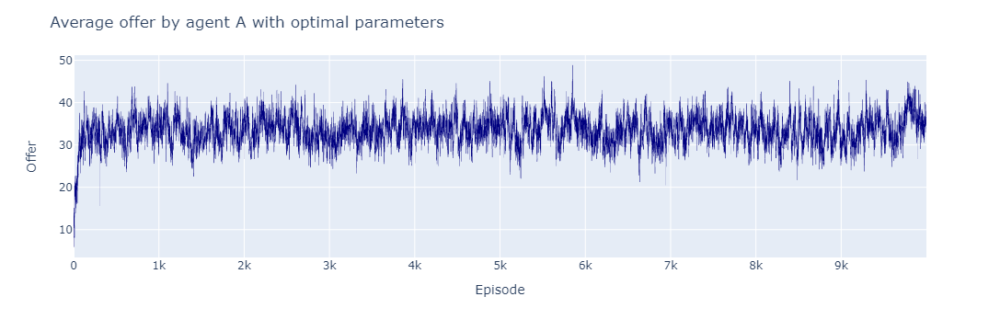

In [18]:
fig = px.line(df_average_actions_a,y="optimal", color_discrete_sequence = ["navy"])
fig.update_traces(line=dict(width=0.5))
fig.update_layout(title = "Average offer by agent A with optimal parameters",xaxis_title="Episode",yaxis_title = "Offer")
fig.show()

Like this, the path of the rewards for agent A does not grow during the simulations to be close to the total endowment.

In [9]:
df_average_rewards_a.iloc[np.r_[0:3,1000:1003, -3:0]]

,optimal
0,38.08
1,31.62
2,57.20
1000,33.40
1001,34.80
1002,30.42
9997,39.14
9998,34.68
9999,36.12


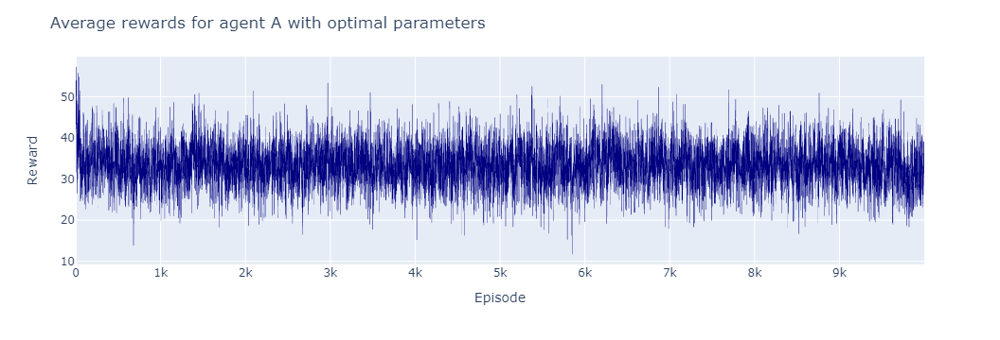

In [19]:
fig = px.line(df_average_rewards_a,y="optimal", color_discrete_sequence = ["navy"])
fig.update_traces(line=dict(width=0.5))
fig.update_layout(title = "Average rewards for agent A with optimal parameters",xaxis_title="Episode",yaxis_title = "Reward")
fig.show()

#### Results for agent B.

The average action of agent B, as should be expected, remains close to 0.5. This is because since the epsilon value is set to 1, all actions taken by agent B are random for each episode, and since both actions, 0 and 1, have the same probability to be picked, the average decision is the average between the two decisions, that is, the agent does not learn to accept all ofers made by agent A. 

In [15]:
df_average_actions_b.iloc[np.r_[0:3,1000:1003, -3:0]]

,alpha = 0.01,alpha = 0.1,alpha = 0.5,alpha = 1
0,0.02,0.02,0.06,0.06
1,0.06,0.02,0.08,0.10
2,0.08,0.00,0.04,0.02
1000,0.24,0.90,0.94,0.26
1001,0.28,0.94,0.94,0.30
1002,0.22,0.92,0.98,0.30
9997,0.88,0.86,0.88,0.88
9998,0.96,0.86,0.84,0.78
9999,0.92,0.88,0.98,0.82


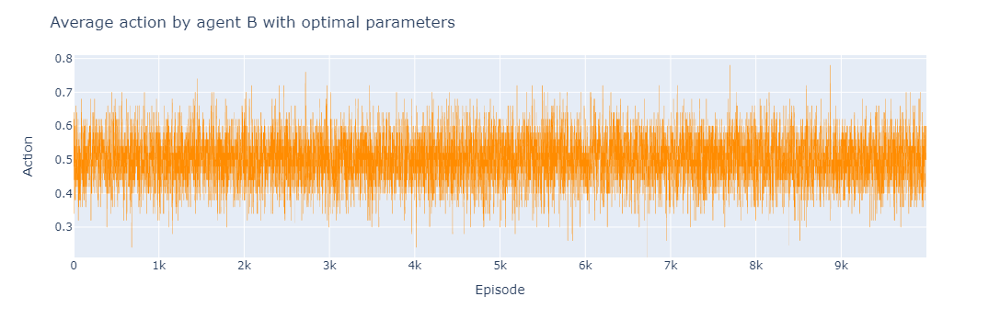

In [20]:
fig = px.line(df_average_actions_b,y="optimal", color_discrete_sequence = ["darkorange"])
fig.update_traces(line=dict(width=0.5))
fig.update_layout(title = "Average action by agent B with optimal parameters",xaxis_title="Episode",yaxis_title = "Action")
fig.show()

Because of the lack of learnig by agent B. The average rewards are a far from the ones in the outcome of the theoretical game. 

In [14]:
df_average_rewards_b.iloc[np.r_[0:3,1000:1003, -3:0]]

,alpha = 0.01,alpha = 0.1,alpha = 0.5,alpha = 1
0,0.0,0.00,0.00,0.0
1,0.0,0.06,0.00,0.0
2,0.0,0.00,0.00,0.0
3,0.0,0.06,1.04,0.0
4,0.0,0.06,1.04,0.0


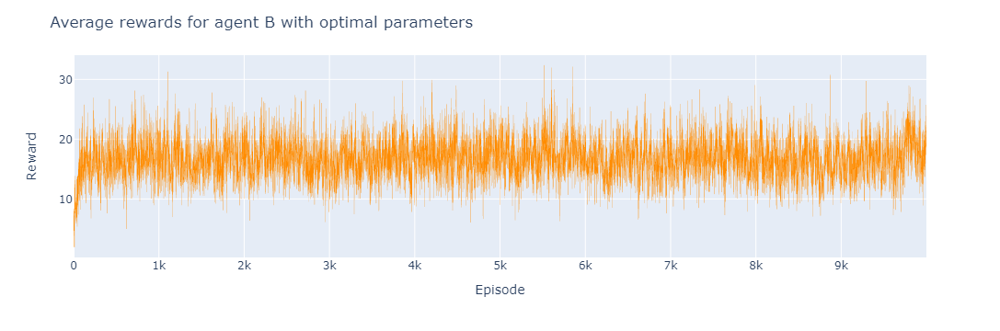

In [21]:
fig = px.line(df_average_rewards_b,y="optimal", color_discrete_sequence = ["darkorange"])
fig.update_traces(line=dict(width=0.3))
fig.update_layout(title = "Average rewards for agent B with optimal parameters",xaxis_title="Episode",yaxis_title = "Reward")
fig.show()

In [17]:
i = "optimal"
print(f"Total of average rewards for {i}: {sum(df_average_rewards_b[i])}")

Total of average rewards for optimal: 167408.0


## Learning against rules

### Fixed rules

For this part of the exercise, the move method for the class player_2 is modified so agent B can follow a rule to take action instead of learning for itself. More precisely, agent B will accept all offers from agent B that are greater than a defined proportion of the endoment p. 
The goal in the exercise is to verify if agent A can learn the policy set for agent B and change the strategy accordingly. A total of 50 simulations is run and agent A keeps the parameters at the optimal value. 

In [1]:
from types import MethodType

In [4]:
def move_fixed_policy(self, state, p):
    endowment = self.states
    if state > p*endowment:
        action = 1
    else:
        action = 0 
    return action

In [6]:
endowment = 100
epsilon = 0.1
alpha = 0.5
policy = 0.2
n_simulations = 50

In [7]:
average_a_actions_dynamic = []
average_b_actions_dynamic = []
average_a_rewards_dynamic = []
average_b_rewards_dynamic = []

names = ["optimal"]

agent_a_actions = []
agent_b_actions = []
agent_a_rewards = []
agent_b_rewards = []

for i in range(n_simulations):
    agent_a = player_1(epsilon = epsilon, alpha_learn_rate=alpha,actions = endowment)
    agent_b = player_2(epsilon = epsilon,alpha_learn_rate=alpha,states = endowment)
    agent_b.move = MethodType(move_fixed_policy,agent_b)
    game = ultimatum(episodes = 10000, player_1 = agent_a, player_2 = agent_b, endowment = endowment, policy = policy)
    game.play()
    agent_a_actions.append(game.player_1_actions)
    agent_b_actions.append(game.player_2_actions)
    agent_a_rewards.append(game.player_1_rewards)
    agent_b_rewards.append(game.player_2_rewards)

average_a_actions = np.mean(agent_a_actions, axis=0)
average_a_actions_dynamic.append(average_a_actions)

average_b_actions = np.mean(agent_b_actions, axis = 0)
average_b_actions_dynamic.append(average_b_actions)

average_a_rewards = np.mean(agent_a_rewards, axis = 0)
average_a_rewards_dynamic.append(average_a_rewards)

average_b_rewards = np.mean(agent_b_rewards, axis = 0)
average_b_rewards_dynamic.append(average_b_rewards)

In [8]:
df_average_actions_a = pd.DataFrame(data = average_a_actions_dynamic).transpose()
df_average_actions_a.columns = names
df_average_actions_b = pd.DataFrame(data = average_b_actions_dynamic).transpose()
df_average_actions_b.columns = names
df_average_rewards_a = pd.DataFrame(data = average_a_rewards_dynamic).transpose()
df_average_rewards_a.columns = names
df_average_rewards_b = pd.DataFrame(data = average_b_rewards_dynamic).transpose()
df_average_rewards_b.columns = names

#### Results for agent A.

The table and plots below show how the average action of agent A converges to the bound set by agent B for the offer to be accepted. So agent A is succesful in learning the rule and modify its strategy accordingly. 

In [9]:
df_average_actions_a.iloc[np.r_[0:3,1000:1003, -3:0]]

,optimal
0,12.72
1,15.84
2,20.92
1000,29.62
1001,29.58
1002,28.88
9997,23.18
9998,26.26
9999,23.20


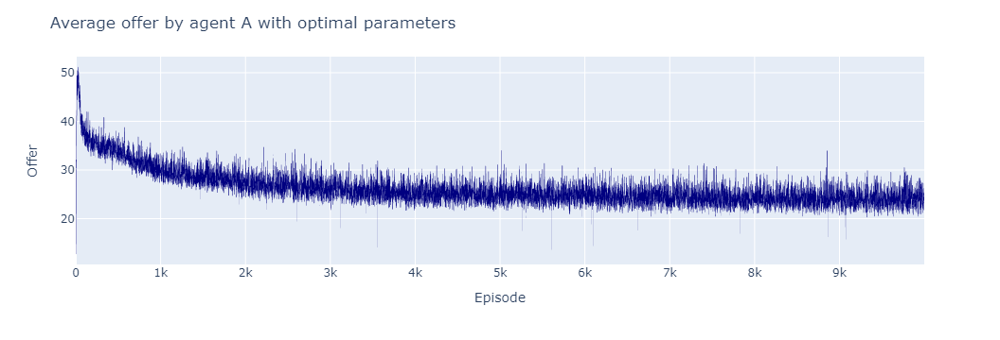

In [10]:
fig = px.line(df_average_actions_a,y="optimal", color_discrete_sequence = ["navy"])
fig.update_traces(line=dict(width=0.5))
fig.update_layout(title = "Average offer by agent A with optimal parameters",xaxis_title="Episode",yaxis_title = "Offer")
fig.show()

Because of the rule set by agent B and the learning of agent A, the rewards for agent B are limited.

In [11]:
df_average_rewards_a.iloc[np.r_[0:3,1000:1003, -3:0]]

,optimal
0,3.76
1,8.16
2,11.74
1000,66.50
1001,64.86
1002,65.88
9997,71.34
9998,71.74
9999,73.26


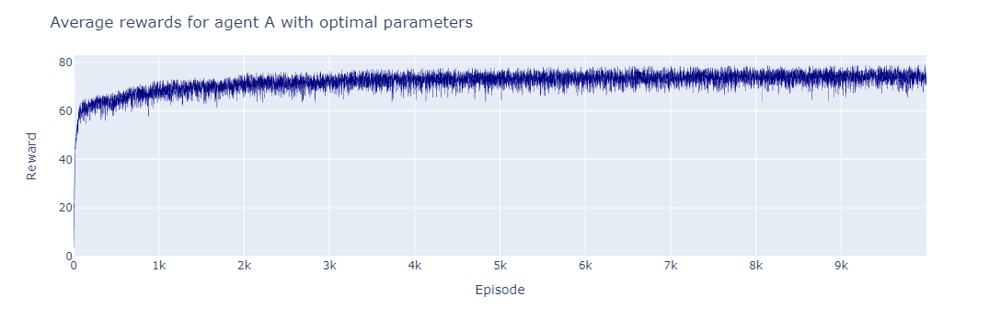

In [12]:
fig = px.line(df_average_rewards_a,y="optimal", color_discrete_sequence = ["navy"])
fig.update_traces(line=dict(width=0.5))
fig.update_layout(title = "Average rewards for agent A with optimal parameters",xaxis_title="Episode",yaxis_title = "Reward")
fig.show()

### Dynamic Rules

In this exercise, agent B keeps following a rule. However, the min proportion of the endowment that agent B is willing to get is dynamic in time. That means, the proportion shifts according to the number of episodes in the simulation. 50 simulations are run and agent A keeps the parameters in their optimal value. 

In [13]:
from types import MethodType

In [14]:
endowment = 100
epsilon = 0.1
alpha = 0.5
policy = 0.4

In [15]:
def move_fixed_policy(self, state, p):
    endowment = self.states
    if state > p*endowment:
        action = 1
    else:
        action = 0 
    return action

In [16]:
policy_values = {2000:0.35,5000:0.45,7000:0.6,10000:0.4}

In [17]:
average_a_actions_dynamic = []
average_b_actions_dynamic = []
average_a_rewards_dynamic = []
average_b_rewards_dynamic = []

names = ["optimal"]

agent_a_actions = []
agent_b_actions = []
agent_a_rewards = []
agent_b_rewards = []

for i in range(n_simulations):
    agent_a = player_1(epsilon = epsilon, alpha_learn_rate=alpha,actions = endowment)
    agent_b = player_2(epsilon = epsilon,alpha_learn_rate=alpha,states = endowment)
    agent_b.move = MethodType(move_fixed_policy,agent_b)
    game = ultimatum(episodes = 10000, player_1 = agent_a, player_2 = agent_b, endowment = endowment, policy = policy)
    game.play(policy_values = policy_values, dynamic = True)
    agent_a_actions.append(game.player_1_actions)
    agent_b_actions.append(game.player_2_actions)
    agent_a_rewards.append(game.player_1_rewards)
    agent_b_rewards.append(game.player_2_rewards)

average_a_actions = np.mean(agent_a_actions, axis=0)
average_a_actions_dynamic.append(average_a_actions)

average_b_actions = np.mean(agent_b_actions, axis = 0)
average_b_actions_dynamic.append(average_b_actions)

average_a_rewards = np.mean(agent_a_rewards, axis = 0)
average_a_rewards_dynamic.append(average_a_rewards)

average_b_rewards = np.mean(agent_b_rewards, axis = 0)
average_b_rewards_dynamic.append(average_b_rewards)

In [18]:
df_average_actions_a = pd.DataFrame(data = average_a_actions_dynamic).transpose()
df_average_actions_a.columns = names
df_average_actions_b = pd.DataFrame(data = average_b_actions_dynamic).transpose()
df_average_actions_b.columns = names
df_average_rewards_a = pd.DataFrame(data = average_a_rewards_dynamic).transpose()
df_average_rewards_a.columns = names
df_average_rewards_b = pd.DataFrame(data = average_b_rewards_dynamic).transpose()
df_average_rewards_b.columns = names

#### Results for agent A.

Following the offers of agent A, it is evident that the agent is capable of learning the shifts in the policy of agent B to accept the offers. 

In [19]:
df_average_actions_a.iloc[np.r_[0:3,1000:1003, -3:0]]

,optimal
0,5.76
1,9.10
2,12.92
1000,46.76
1001,48.94
1002,48.00
9997,60.34
9998,61.30
9999,60.18


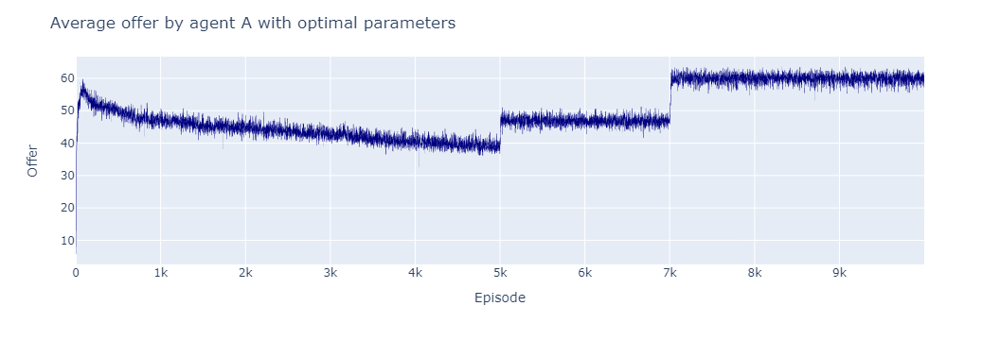

In [20]:
fig = px.line(df_average_actions_a,y="optimal", color_discrete_sequence = ["navy"])
fig.update_traces(line=dict(width=0.5))
fig.update_layout(title = "Average offer by agent A with optimal parameters",xaxis_title="Episode",yaxis_title = "Offer")
fig.show()

The learning process makes the agent take the greedy action in 90% percent of the episodes, however, when the policy for agent B shifts and the agent A keeps taking the greedy action, this one results on a reward of 0, with several mistakes made, the q-table for agent A is sucessfully updated,and agent A modifies the offer. The 0 units rewards can be easily spot in the plot below. 

In [21]:
df_average_rewards_a.iloc[np.r_[0:3,1000:1003, -3:0]]

,optimal
0,1.78
1,3.84
2,7.84
1000,51.24
1001,49.38
1002,47.74
9997,37.06
9998,36.86
9999,37.22


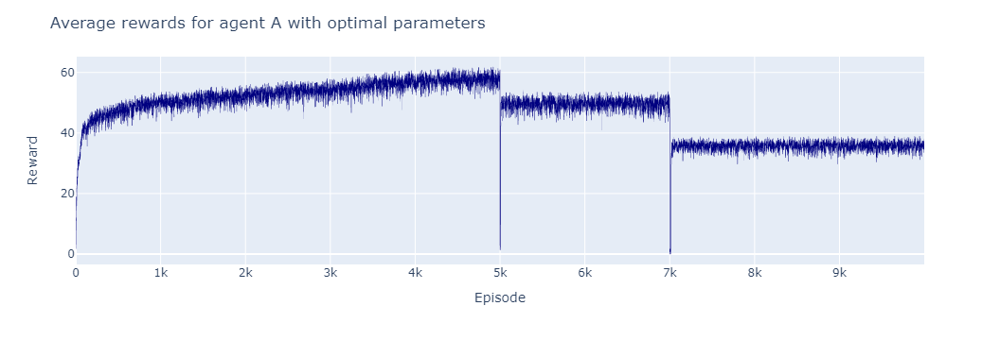

In [22]:
fig = px.line(df_average_rewards_a,y="optimal", color_discrete_sequence = ["navy"])
fig.update_traces(line=dict(width=0.5))
fig.update_layout(title = "Average rewards for agent A with optimal parameters",xaxis_title="Episode",yaxis_title = "Reward")
fig.show()